## 1. Imports and definitions

In [28]:
import pandas as pd
import numpy as np

# Modelling and Forecasting
# ==============================================================================
import sklearn
import skforecast
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from skforecast.ForecasterAutoregMultiSeries import ForecasterAutoregMultiSeries
from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.model_selection import backtesting_forecaster
from skforecast.model_selection import bayesian_search_forecaster
from skforecast.model_selection_multiseries import backtesting_forecaster_multiseries
from skforecast.model_selection_multiseries import bayesian_search_forecaster_multiseries
from skforecast.model_selection_multiseries import select_features_multiseries
from skforecast.plot import set_dark_theme
from skforecast.preprocessing import series_long_to_dict
from skforecast.preprocessing import exog_long_to_dict

# Viz
# ==============================================================================
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as poff
plt.style.use('seaborn-v0_8-darkgrid')


### 1.1. Cyclical functions - doesn't work

In [29]:
# Cliclical encoding of direction features
# ==============================================================================
def cyclical_encoding(data: pd.Series, cycle_length: int) -> pd.DataFrame:
    """
    Encode a cyclical feature with two new features sine and cosine.
    The minimum value of the feature is assumed to be 0. The maximum value
    of the feature is passed as an argument.
      
    Parameters
    ----------
    data : pd.Series
        Series with the feature to encode.
    cycle_length : int
        The length of the cycle. For example, 12 for months, 24 for hours, etc.
        This value is used to calculate the angle of the sin and cos.

    Returns
    -------
    result : pd.DataFrame
        Dataframe with the two new features sin and cos.

    """

    sin = np.sin(2 * np.pi * data/cycle_length)
    cos = np.cos(2 * np.pi * data/cycle_length)
    result =  pd.DataFrame({
                  f"{data.name}_sin": sin,
                  f"{data.name}_cos": cos
              })

    return result


In [30]:
from sklearn.base import BaseEstimator, TransformerMixin
import numpy as np
import pandas as pd

class SineCosineEncoder(BaseEstimator, TransformerMixin):
    def __init__(self, cycle_length=360):
        self.cycle_length = cycle_length
        self.transform_storage = {}
        self.last_series_name = None

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        if isinstance(X, pd.DataFrame):
            self.last_series_name = X.columns[0]
            self.series_index = X.index
            X = X.iloc[:, 0]
        elif isinstance(X, pd.Series):
            self.last_series_name = X.name
            self.series_index = X.index
        else:
            raise ValueError("Input must be a pandas DataFrame or Series.")
        
        X = np.asarray(X).ravel()
        sine = np.sin(2 * np.pi * X / self.cycle_length)
        cosine = np.cos(2 * np.pi * X / self.cycle_length)
        
        # Store the cosine components by series name
        self.transform_storage[self.last_series_name] = cosine
        
        return pd.DataFrame({self.last_series_name: sine}, index=self.series_index)

    def inverse_transform(self, X):
        if self.last_series_name not in self.transform_storage:
            raise ValueError("Transformation has not been applied yet for the series.")

        if not isinstance(X, pd.DataFrame):
            raise ValueError("Input must be a pandas DataFrame.")
        
        series_name = X.columns[0]
        if series_name not in self.transform_storage:
            raise ValueError(f"Transformation has not been applied yet for the series '{series_name}'.")

        sine = np.asarray(X[series_name]).ravel()
        cosine = self.transform_storage[series_name]
        
        if len(sine) > len(cosine):
            raise ValueError(f"Shape mismatch: sine length is {len(sine)}, but expected length is {len(cosine)}.")
        
        # Trim cosine to match the length of sine
        cosine = cosine[:len(sine)]
        
        # Calculate angles from sine and cosine
        angles = np.arctan2(sine, cosine)
        return pd.Series(angles * self.cycle_length / (2 * np.pi), index=X.index, name=series_name)

    def get_feature_names_out(self, input_features=None):
        return [self.last_series_name if self.last_series_name else 'sine_component']


## 2. Read and transform data 

In [31]:
# Read data in
data_dir = '../../Data/mooloolaba'
file = '/mool_all.csv'

df = pd.read_csv(data_dir + file)
df['datetime'] = pd.to_datetime(df['datetime'])
df.set_index(keys = 'datetime', inplace=True)
df = df.asfreq('30T')

df.head()

,wave_height_significant,wave_height_max,wave_period_upx,wave_period_peak,wave_direction,sea_temperature
datetime,,,,,,
2022-01-01 00:00:00,2.477,4.110,6.136,8.230,90.0,25.75
2022-01-01 00:30:00,2.259,3.240,5.871,8.179,98.0,25.75
2022-01-01 01:00:00,2.268,4.280,5.752,8.174,87.0,25.80
2022-01-01 01:30:00,2.452,3.970,5.987,8.719,80.0,25.80
2022-01-01 02:00:00,2.260,3.514,5.824,8.654,90.0,25.75


In [32]:
# Slice off target variables
target_vars = ['wave_height_max', 'wave_period_upx', 'wave_direction']
df_target = df[target_vars].copy()
df_target.rename(columns={
    'wave_height_max':'wave_height',
    'wave_period_upx':'wave_period',
}, inplace=True)
df_target

,wave_height,wave_period,wave_direction
datetime,,,
2022-01-01 00:00:00,4.110,6.136,90.0
2022-01-01 00:30:00,3.240,5.871,98.0
2022-01-01 01:00:00,4.280,5.752,87.0
2022-01-01 01:30:00,3.970,5.987,80.0
2022-01-01 02:00:00,3.514,5.824,90.0
...,...,...,...
2024-03-31 21:30:00,2.220,4.937,125.0
2024-03-31 22:00:00,2.300,5.370,83.0
2024-03-31 22:30:00,2.150,5.186,85.0


In [33]:
# # Transform wave direction variable into a cyclical variable, as the original variable is in degrees, from 0 to 360
# direction_cycle = cyclical_encoding(df['wave_direction'], cycle_length=360)

# # Replace direction variable with one of the produced variables. Could be either sine or cosine, we are indifferent
# df_target['wave_direction_sine'] = direction_cycle['wave_direction_sin']
# df_target.drop(columns = ['wave_direction'], inplace = True)
# df_target


In [34]:
df_target.isnull().value_counts()

wave_height  wave_period  wave_direction
False        False        False             38607
True         True         True                758
False        False        True                 39
True         True         False                 4
Name: count, dtype: int64

In [35]:
# Train-test split
# ==============================================================================
one_month = (-1)*30*48 # One month
two_months = (-1)*60*48 # Two months

end_val = two_months
end_train = end_val + two_months 

df_train = df_target.iloc[:end_train].copy()
df_val = df_target.iloc[end_train:end_val].copy()
df_test = df_target.iloc[end_val:].copy()

print(f"Train dates      : {df_train.index.min()} --- {df_train.index.max()}  (n={len(df_train)})")
print(f"Validation dates : {df_val.index.min()} --- {df_val.index.max()}  (n={len(df_val)})")
print(f"Test dates       : {df_test.index.min()} --- {df_test.index.max()}  (n={len(df_test)})")

Train dates      : 2022-01-01 00:00:00 --- 2023-12-02 23:30:00  (n=33648)
Validation dates : 2023-12-03 00:00:00 --- 2024-01-31 23:30:00  (n=2880)
Test dates       : 2024-02-01 00:00:00 --- 2024-03-31 23:30:00  (n=2880)


## 3. Modelling

In [36]:
# Train and backtest a model for all items: ForecasterAutoregMultiSeries
# ======================================================================================
items = list(df_target.columns)

# Define forecaster
forecaster_ms = ForecasterAutoregMultiSeries(
                    regressor          = LGBMRegressor(random_state=42),
                    lags               = 24,
                    encoding           = 'ordinal'
                  #   transformer_series = {'wave_direction':SineCosineEncoder()}
                )
# Backtesting forecaster for all items
multi_series_mae, predictions_ms = backtesting_forecaster_multiseries(
                                       forecaster            = forecaster_ms,
                                       series                = df_target,
                                       levels                = None,
                                       steps                 = 24,
                                       metric                = 'mean_absolute_error',
                                    #    add_aggregated_metric = False,
                                       initial_train_size    = len(df_train) + len(df_val),
                                       refit                 = False,
                                       fixed_train_size      = False,
                                       verbose               = False,
                                       show_progress         = True 
                                    )
# Results
display(multi_series_mae.head(3))
print('')
display(predictions_ms.head(3))



/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005975 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6123
[LightGBM] [Info] Number of data points in the train set: 107196, number of used features: 25
[LightGBM] [Info] Start training from score -0.000442


  0%|          | 0/120 [00:00<?, ?it/s]

,levels,mean_absolute_error
0,wave_height,0.321054
1,wave_period,0.326580
2,wave_direction,9.077448


,wave_height,wave_period,wave_direction
2024-02-01 00:00:00,3.697181,5.716295,104.360825
2024-02-01 00:30:00,3.647067,5.737963,105.140727
2024-02-01 01:00:00,3.651655,5.769890,104.891603


In [37]:
predictions_ms

,wave_height,wave_period,wave_direction
2024-02-01 00:00:00,3.697181,5.716295,104.360825
2024-02-01 00:30:00,3.647067,5.737963,105.140727
2024-02-01 01:00:00,3.651655,5.769890,104.891603
2024-02-01 01:30:00,3.688061,5.733783,104.427792
2024-02-01 02:00:00,3.693120,5.736864,104.591361
...,...,...,...
2024-03-31 21:30:00,2.229152,5.387148,82.186984
2024-03-31 22:00:00,2.236839,5.394861,81.987263
2024-03-31 22:30:00,2.238886,5.389770,82.130535
2024-03-31 23:00:00,2.231198,5.389770,82.130535


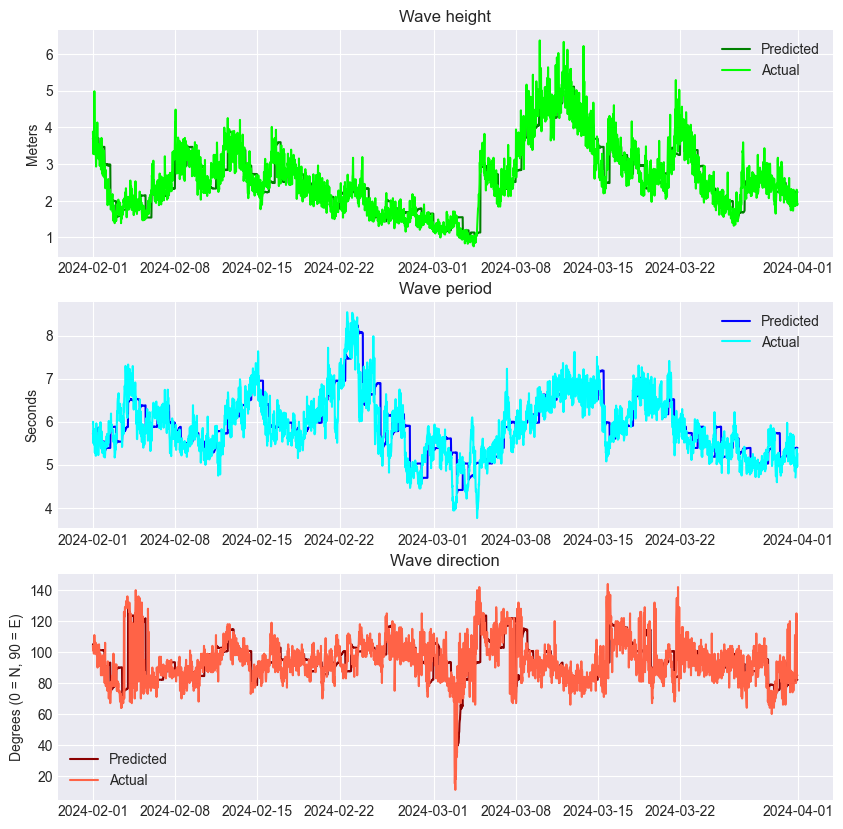

In [38]:
# Plot predictions vs real value
# ======================================================================================
fig, ax = plt.subplots(3, 1, figsize = (10,10))

ax[0].plot(predictions_ms['wave_height'], color = 'green', label = 'Predicted')
ax[0].plot(df_test['wave_height'], color = 'lime', label = 'Actual')
ax[0].set_ylabel('Meters')
ax[0].set_title('Wave height')

ax[1].plot(predictions_ms['wave_period'], color = 'blue', label = 'Predicted')
ax[1].plot(df_test['wave_period'], color = 'cyan', label = 'Actual')
ax[1].set_ylabel('Seconds')
ax[1].set_title('Wave period')

ax[2].plot(predictions_ms['wave_direction'], color = 'darkred', label = 'Predicted')
ax[2].plot(df_test['wave_direction'], color = 'tomato', label = 'Actual')
ax[2].set_ylabel('Degrees (0 = N, 90 = E)')
ax[2].set_title('Wave direction')

for axi in ax:
    axi.legend()

plt.show()

### 3.2 Hyperparameter search

In [39]:
# Hyperparameter search for the multi-series model and backtesting for each item
# ======================================================================================
def search_space(trial):
    search_space = {
        'lags': trial.suggest_categorical('lags', [24, 36, 48]),
        'n_estimators': trial.suggest_int('n_estimators', 600, 1000, step=100),
        'max_depth': trial.suggest_int('max_depth', 6, 12, step=1),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.1),
        # 'reg_alpha': trial.suggest_float('reg_alpha', 0, 0.5, step=0.1),
        # 'reg_lambda': trial.suggest_float('reg_lambda', 0, 0.5, step=0.1),
        'subsample': trial.suggest_float('subsample', 0.6, 1, step=0.1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.6, 1, step=0.1),
        'min_gain_to_split': trial.suggest_float('min_gain_to_split', 0, 0.2, step=0.05),
        # 'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 10, 30, step=5)
    }
    
    return search_space

forecaster_ms = ForecasterAutoregMultiSeries(
                    regressor          = LGBMRegressor(random_state=42),
                    lags               = 24,
                    # transformer_series = StandardScaler(),
                    encoding           = 'ordinal'
                )

results_bayesian_ms = bayesian_search_forecaster_multiseries(
                        forecaster         = forecaster_ms,
                        series             = df_target.iloc[:end_val, :],
                        levels             = None, # If None all levels are selected
                        search_space       = search_space,
                        n_trials           = 35,
                        steps              = 24,
                        metric             = 'mean_absolute_error',
                        initial_train_size = len(df_train),
                        refit              = False,
                        fixed_train_size   = False,
                        return_best        = True,
                        verbose            = False,
                        show_progress      = False 
                    )      

multi_series_mae, predictions_ms = backtesting_forecaster_multiseries(
                                       forecaster             = forecaster_ms,
                                       series                 = df_target,
                                       levels                 = None, # If None all levels are selected
                                       steps                  = 24,
                                       metric                 = 'mean_absolute_error',
                                        # add_aggregated_metric = False,
                                       initial_train_size     = len(df_train) + len(df_val),
                                       refit                  = False,
                                       fixed_train_size       = False,
                                       verbose                = False
                                   )

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006701 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6123
[LightGBM] [Info] Number of data points in the train set: 98575, number of used features: 25
[LightGBM] [Info] Start training from score -0.000451
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positiv

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008659 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011012 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_g

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008273 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_g

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05

[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.026767 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014438 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018641 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000957 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 9183
[LightGBM] [Info] Number of data points in the train set: 98539, number of used features: 37
[LightGBM] [Info] Start training from score -0.000739
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005997 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9183
[LightGBM] [Info] Number of data points in the train set: 98539, number of used features: 37
[LightGBM] [Info] Start training from score -0.000739
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, mi

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004209 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6123
[LightGBM] [Info] Number of data points in the train set: 98575, number of used features: 25
[LightGBM] [Info] Start training from score -0.000451
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_ga

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.05
[LightGBM] [Warning] min_gain_to_split is set=0.05, min_split_gain=0.0 will be ignored. Current value: min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005874 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9183
[LightGBM] [Info] Number of data points in the train set: 98539, number of used features: 37
[LightGBM] [Info] Start training from score -0.000739
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012458 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011295 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012415 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.071115 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[Lig

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004023 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6123
[LightGBM] [Info] Number of data points in the train set: 98575, number of used features: 25
[LightGBM] [Info] Start training from score -0.000451
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warn

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/Forec

[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.012000 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further s

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(



[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightG

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.044544 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training becaus

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.150000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.150000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005978 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9183
[LightGBM] [Info] Number of data points in the train set: 98539, number of used features: 37
[LightGBM] [Info] Start training from score -0.000739
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positiv

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2

[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001465 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 6123
[LightGBM] [Info] Number of data points in the train set: 98575, number of used features: 25
[LightGBM] [Info] Start training from score -0.000451
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warn

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1

[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015957 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.040973 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.080462 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010799 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Lig

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016252 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [War

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011007 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Lig

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015913 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training becaus

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014549 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positi

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001321 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 6123
[LightGBM] [Info] Number of data points in the train set: 98575, number of used features: 25
[LightGBM] [Info] Start training from score -0.000451
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stoppe

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


02, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010691 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9183
[LightGBM] [Info] Number of data points in the train set: 98539, number of used features: 37
[LightGBM] [Info] Start training from score -0.000739
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positiv

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.2, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004849 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 6123
[LightGBM] [Info] Number of data points in the train set: 98575, number of used features: 25
[LightGBM] [Info] Start training from score -0.000451
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGBM] [Warning] min_gain_to_split is set=0.1, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015237 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [War

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.087510 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024258 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_spl

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGBM] [Warning] min_gain_to_split is set=0.0, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0
[LightGB

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 98503, number of used features: 49
[LightGBM] [Info] Start training from score -0.000950
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(
/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/utils/utils.py:799: MissingValuesWarning: `last_window` has missing values. Most of machine learning models do not allow missing values. `predict` method may fail. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)
  warnings.warn(


[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.018477 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 107124, number of used features: 49
[LightGBM] [Info] Start training from score -0.000932
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:783: MissingValuesWarning:

NaNs detected in `y_train`. They have been dropped because the target variable cannot have NaN values. Same rows have been dropped from `X_train` to maintain alignment. This is caused by series with interspersed NaNs. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)

/Users/alvarocorralescano/opt/anaconda3/envs/waves/lib/python3.11/site-packages/skforecast/ForecasterAutoregMultiSeries/ForecasterAutoregMultiSeries.py:805: MissingValuesWarning:

NaNs detected in `X_train`. Some regressors do not allow NaN values during training. If you want to drop them, set `forecaster.dropna_from_series = True`. 
 You can suppress this warning using: warnings.simplefilter('ignore', category=MissingValuesWarning)



[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.021539 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12243
[LightGBM] [Info] Number of data points in the train set: 107124, number of used features: 49
[LightGBM] [Info] Start training from score -0.000932
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

  0%|          | 0/120 [00:00<?, ?it/s]

[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

In [40]:
# Results
display(multi_series_mae.head(3))
print('')
display(predictions_ms.head(3))

,levels,mean_absolute_error
0,wave_height,0.323603
1,wave_period,0.327187
2,wave_direction,9.048828


,wave_height,wave_period,wave_direction
2024-02-01 00:00:00,3.699587,5.709802,104.138085
2024-02-01 00:30:00,3.662916,5.719367,104.835847
2024-02-01 01:00:00,3.652626,5.749228,104.055911


In [41]:
# Save the model to a file using pickle
import pickle
with open('../../Models/mooloolaba/forecaster_mool.pkl', 'wb') as file:
    pickle.dump(forecaster_ms, file)

In [42]:
# Load model back
# with open('forecaster.pkl', 'rb') as file:
#     forecaster = pickle.load(file)

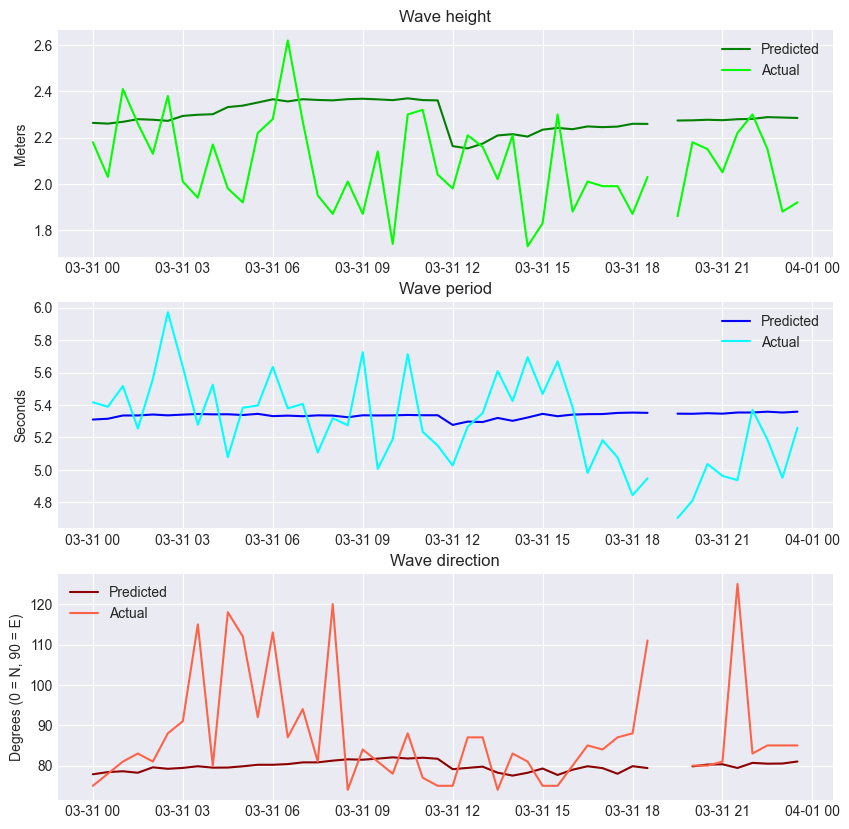

In [43]:
# Plot predictions vs real value
# ======================================================================================
fig, ax = plt.subplots(3, 1, figsize = (10,10))

ax[0].plot(predictions_ms['wave_height'][-48:], color = 'green', label = 'Predicted')
ax[0].plot(df_test['wave_height'][-48:], color = 'lime', label = 'Actual')
ax[0].set_ylabel('Meters')
ax[0].set_title('Wave height')

ax[1].plot(predictions_ms['wave_period'][-48:], color = 'blue', label = 'Predicted')
ax[1].plot(df_test['wave_period'][-48:], color = 'cyan', label = 'Actual')
ax[1].set_ylabel('Seconds')
ax[1].set_title('Wave period')

ax[2].plot(predictions_ms['wave_direction'][-48:], color = 'darkred', label = 'Predicted')
ax[2].plot(df_test['wave_direction'][-48:], color = 'tomato', label = 'Actual')
ax[2].set_ylabel('Degrees (0 = N, 90 = E)')
ax[2].set_title('Wave direction')

for axi in ax:
    axi.legend()

plt.show()

In [44]:
results_bayesian_ms[0].head(2)

,levels,lags,params,mean_absolute_error,n_estimators,max_depth,learning_rate,subsample,colsample_bytree,min_gain_to_split
17,"[wave_height, wave_period, wave_direction]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'n_estimators': 1000, 'max_depth': 11, 'learn...",5.17774,1000.0,11.0,0.065681,0.7,0.8,0.15
31,"[wave_height, wave_period, wave_direction]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'n_estimators': 800, 'max_depth': 12, 'learni...",5.20606,800.0,12.0,0.068678,0.6,0.8,0.15


In [45]:
results_bayesian_ms[0]['lags'][0]

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24])

In [47]:
preds = forecaster_ms.predict(24)

[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.15000000000000002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.15000000000000002
[LightGBM] [Warning] min_gain_to_split is set=0.1500000000000000

In [50]:
preds.index.name = 'Date/Time'
preds

,wave_direction,wave_height,wave_period
Date/Time,,,
2024-02-01 00:00:00,104.138085,3.699587,5.709802
2024-02-01 00:30:00,104.835847,3.662916,5.719367
2024-02-01 01:00:00,104.055911,3.652626,5.749228
2024-02-01 01:30:00,104.537741,3.668268,5.710440
2024-02-01 02:00:00,104.239023,3.657336,5.719101
2024-02-01 02:30:00,104.777588,3.681816,5.737216
2024-02-01 03:00:00,104.005081,3.694614,5.716948
2024-02-01 03:30:00,104.766670,3.668619,5.716135
2024-02-01 04:00:00,104.699918,3.677470,5.713416


In [56]:
import plotly.graph_objects as go

# Create random data with numpy
# import numpy as np
# np.random.seed(1)

# N = 100
# random_x = np.linspace(0, 1, N)
# random_y0 = np.random.randn(N) + 5
# random_y1 = np.random.randn(N)
# random_y2 = np.random.randn(N) - 5

# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(y=preds['wave_height'], x=preds.index,
                    mode='lines',
                    name='lines'))
# fig.add_trace(go.Scatter(x=random_x, y=random_y1,
#                     mode='lines+markers',
#                     name='lines+markers'))
# fig.add_trace(go.Scatter(x=random_x, y=random_y2,
#                     mode='markers', name='markers'))

fig.show()